<a href="https://colab.research.google.com/github/Akmallabib/FCVK_Jobsheet1/blob/main/PCVK_Jobsheet5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


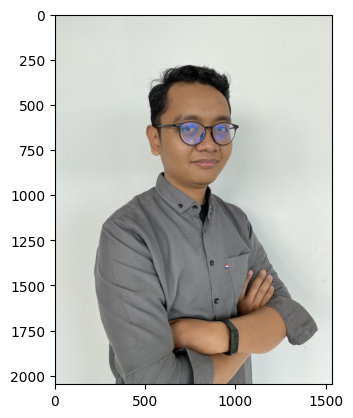

In [2]:
import cv2 as cv
from google.colab.patches import cv2_imshow
from skimage import io
import matplotlib.pyplot as plt
import numpy as np
img = cv.imread('/content/drive/MyDrive/fotoawakdewe.jpg')
img_rgb = cv.cvtColor(img,cv.COLOR_BGR2RGB)
plt.imshow(img_rgb)

 Gamma Correction pada citra 
----------------------------------


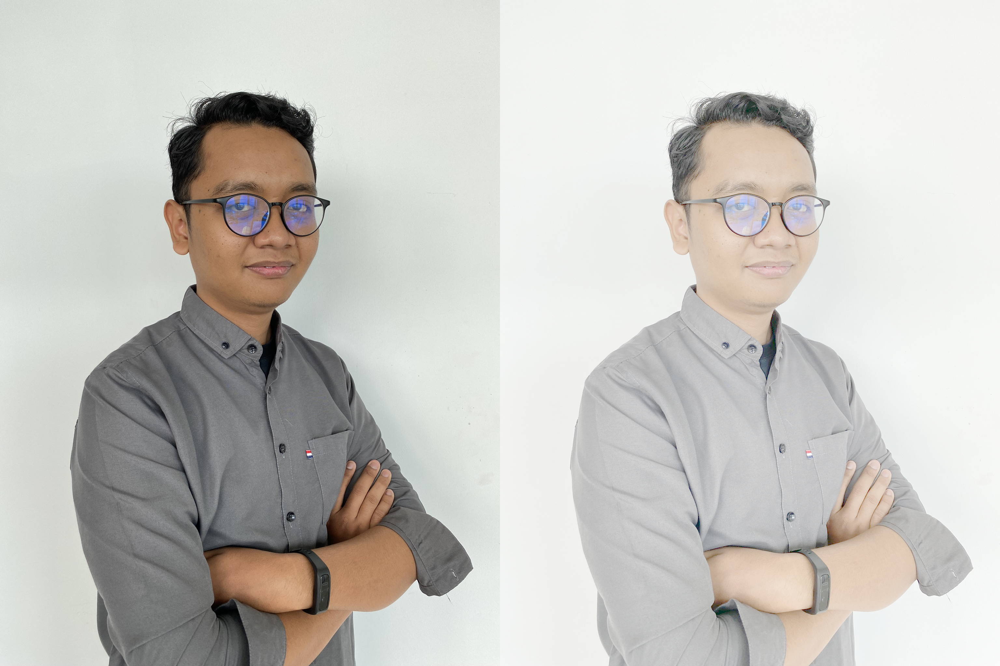

In [3]:
## NO 1: Gamma Correction
print(' Gamma Correction pada citra ')
print('----------------------------------')
try: 
 gamma = int(input('Masukkan nilai Gamma: '))
except ValueError:
 print('Error, not a number')

ori = cv.cvtColor(img_rgb,cv.COLOR_BGR2RGB)
gamma_img = np.zeros(ori.shape, ori.dtype)

#akses per pixel
for y in range(ori.shape[0]):
  for x in range(ori.shape[1]):
    for c in range(ori.shape[2]):

     gamma_img[y,x,c] = np.clip(255 * pow(ori[y,x,c] / 255, (1 / gamma)), 0, 255)
     
final_frame = cv.hconcat((ori, gamma_img))
cv2_imshow(final_frame)
     

 Simulasi Image Depth 
----------------------
Masukkan nilai Bit Depth: 3


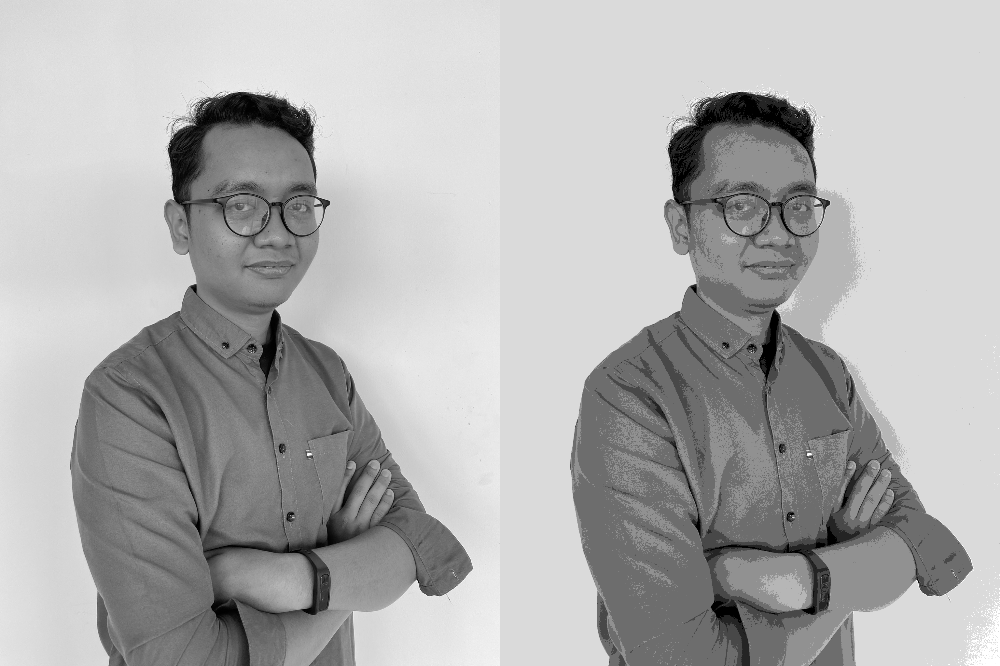

In [4]:
## NO 2: Simulasi Image Depth
ori = cv.imread('/content/drive/MyDrive/fotoawakdewe.jpg', cv.IMREAD_GRAYSCALE)
depth_img = np.zeros(ori.shape, ori.dtype)

print(' Simulasi Image Depth ')
print('----------------------')
try:
  bit_depth = float(input('Masukkan nilai Bit Depth: '))
except ValueError:
  print('Error, not a number')

bit = 2**bit_depth
level = 255/(bit-1)

for y in range(ori.shape[0]):
  for x in range(ori.shape[1]):
    depth_img[y,x] = np.clip(round(ori[y,x]/level) * level, 0, 255)

final_frame = cv.hconcat((ori, depth_img))
cv2_imshow(final_frame)
     

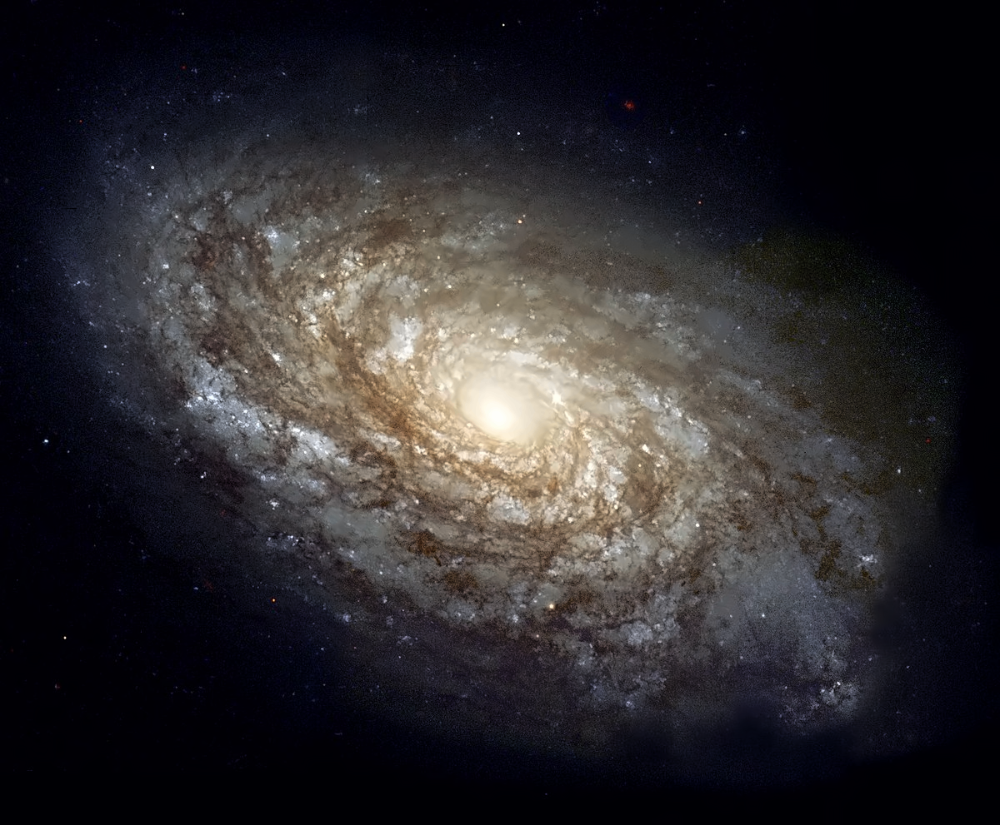

In [5]:
## NO 3
import glob
from math import log10, sqrt
cv_img = []

for img in glob.glob('/content/drive/MyDrive/Image/*.jpg'):
    n = cv.imread(img)
    cv_img.append(n)

dst = cv.fastNlMeansDenoisingColoredMulti(cv_img, 99, 1)
cv2_imshow(dst)


In [6]:
def PSNR(img,amount):
  image1 = img[0]
  for x in range(1,amount):
    if(x==0):
      continue
    image1 = image1 - img[x]
    # print(x)
  mse = np.mean((image1) ** 2)
  if(mse == 0): 
    return 100
  pixel = 255.0
  psnr = 20 * log10(pixel / sqrt(mse))
  return psnr

print(' PSNR ')
print('----------------------------------')
try:
  avg_denoising = int(input('Masukkan nilai Average Denoising: '))
except ValueError:
  print('Error, not a number')
psnr= PSNR(cv_img,avg_denoising)
print('Nilai PSNR adalah: ',psnr, '(dB)')

 PSNR 
----------------------------------
Masukkan nilai Average Denoising: 100
Nilai PSNR adalah:  28.69543642558174 (dB)


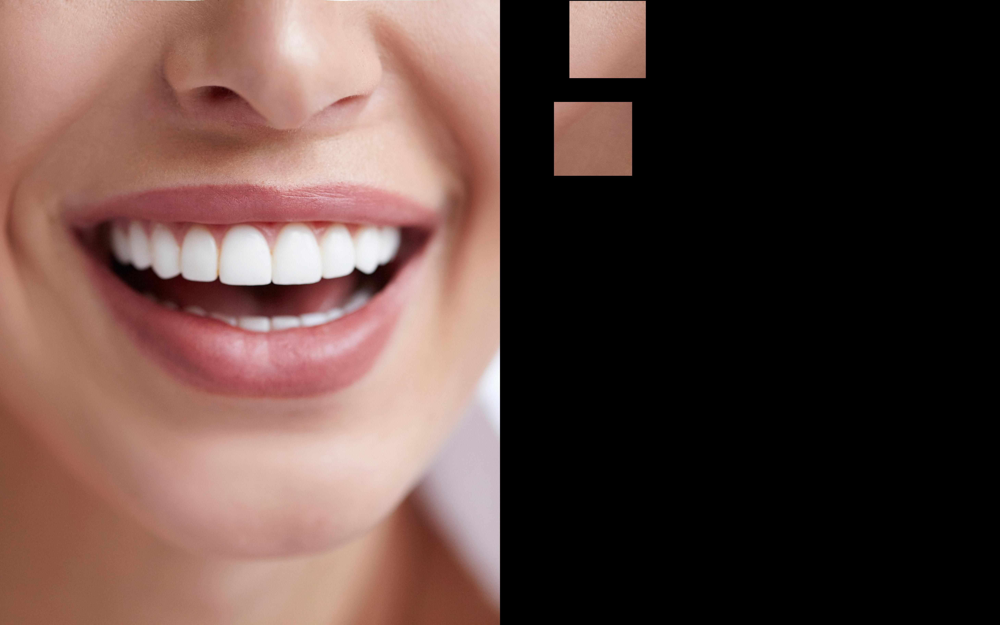

In [7]:
##NO 4
ori = image = cv.imread('/content/drive/MyDrive/teeth.jpg')

mask = np.zeros(ori.shape, dtype=np.uint8)
mask = cv.rectangle(mask,pt1=(315,595),pt2=(770,1025),color=(255,255,255),thickness=-1)

result = ori & mask

mask1 = cv.rectangle(mask,pt1=(405,5),pt2=(850,455),color=(255,255,255),thickness=-1)

result = ori & mask1

teeth_frame = cv.hconcat((ori, result))
cv2_imshow(teeth_frame)

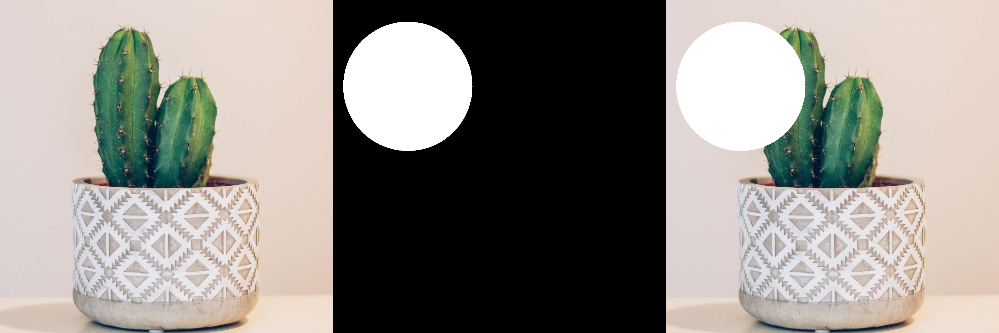

In [8]:
##NO 5
## OR
rose = cv.imread('/content/drive/MyDrive/kaktus.jpg')

mask = np.zeros(rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (260, 300), 225, (255,255,255), -1)

masked = rose | mask

rose_frame = cv.hconcat((rose, mask, masked))
cv2_imshow(rose_frame)

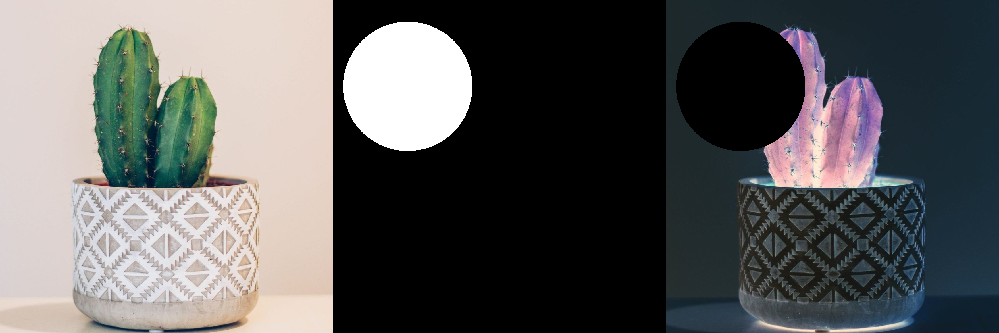

In [9]:
## NOT
mask = np.zeros(rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (260, 300), 225, (255,255,255), -1)

masked = ~rose & ~mask

rose_frame = cv.hconcat((rose, mask, masked))
cv2_imshow(rose_frame)

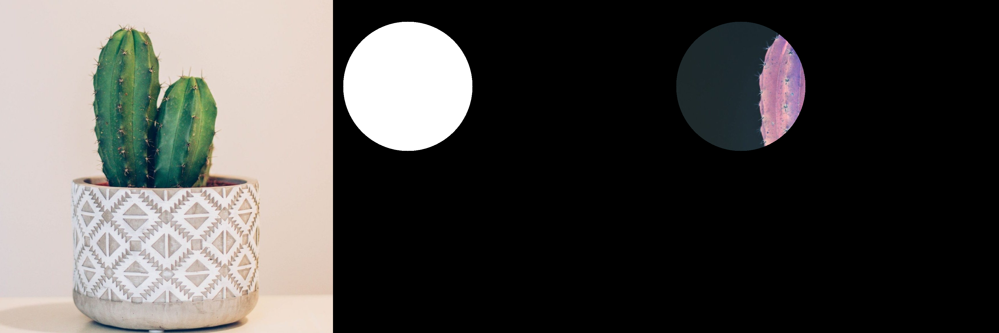

In [10]:
## NAND
mask = np.zeros(rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (260, 300), 225, (255,255,255), -1)

masked = ~rose & mask

rose_frame = cv.hconcat((rose, mask, masked))
cv2_imshow(rose_frame)

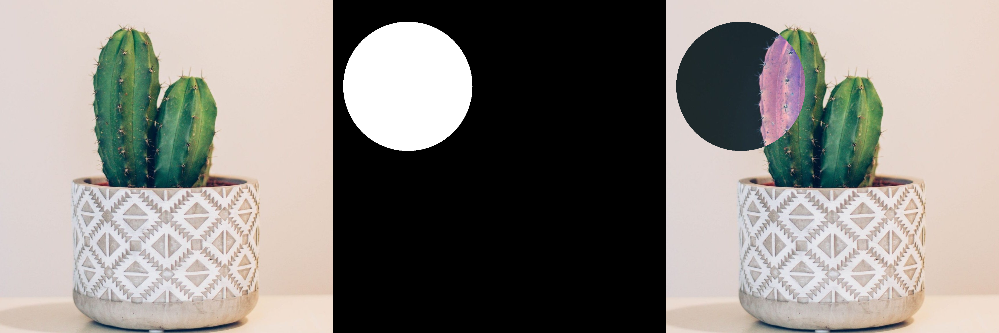

In [11]:
## XOR
mask = np.zeros(rose.shape, dtype=np.uint8)
mask = cv.circle(mask, (260, 300), 225, (255,255,255), -1)

masked = rose ^ mask

rose_frame = cv.hconcat((rose, mask, masked))
cv2_imshow(rose_frame)